In [25]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

<h1>Background</h1>

This Kaggle competition project is to build a GAN that generates 7,000 to 10,000 Monet-style images.

What is GAN?

Generative Adversarial Network (GAN) is a deep learning model that uses two competing neural networks—a generator and a discriminator—to create new, realistic data that is similar to a training dataset. The generator creates fake data, while the discriminator tries to distinguish between the real data and the fake data. This adversarial competition drives both networks to improve: the generator gets better at creating convincing fakes, and the discriminator gets better at spotting them.(from https://aws.amazon.com/what-is/gan/)

Evaluation method is MiFID.

In [13]:
import random
import matplotlib.pyplot as plt
from PIL import Image
from glob import glob
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.utils as vutils
import torchvision.transforms as T

from scipy.spatial.distance import cosine


In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [15]:
# Training config
IMG_SIZE = 256         
BATCH_SIZE = 4     
LR = 2e-4
NUM_EPOCHS = 20      
LAMBDA_CYCLE = 10
LAMBDA_IDENTITY = 5        # identity loss weight
SAVE_EVERY = 1         # save sample per epoch
MAX_STEPS = 20

SEED = 42

random.seed(SEED)
torch.manual_seed(SEED)
np.random.seed(SEED)

print(f"IMG_SIZE={IMG_SIZE}, BATCH_SIZE={BATCH_SIZE}, LR={LR}, EPOCHS={NUM_EPOCHS}")

IMG_SIZE=256, BATCH_SIZE=4, LR=0.0002, EPOCHS=40


<h1>Data</h1>
Our dataset includes 4 folders.
Monet files are Monet-style images and photo files are regular images.
I choose to use JPG files for PyTorch since the TFRec format is for TensorFlow.

In [16]:
MONET_JPG = "/kaggle/input/gan-getting-started/monet_jpg/"
PHOTO_JPG = "/kaggle/input/gan-getting-started/photo_jpg/"

monet_paths = sorted(glob(MONET_JPG + "*.jpg"))
photo_paths = sorted(glob(PHOTO_JPG + "*.jpg"))

len(monet_paths), len(photo_paths)

(300, 7038)

<h2>Images Preview</h2>
Preview the difference between Monet images and Photo images

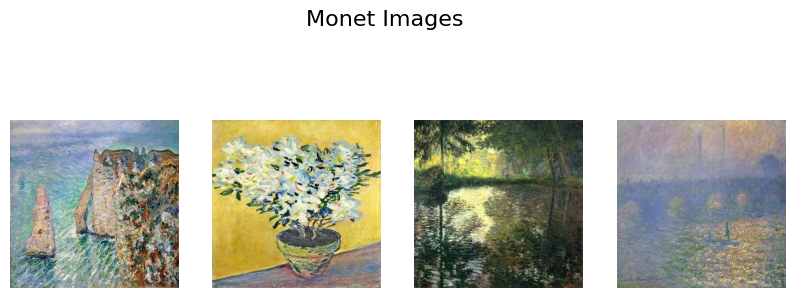

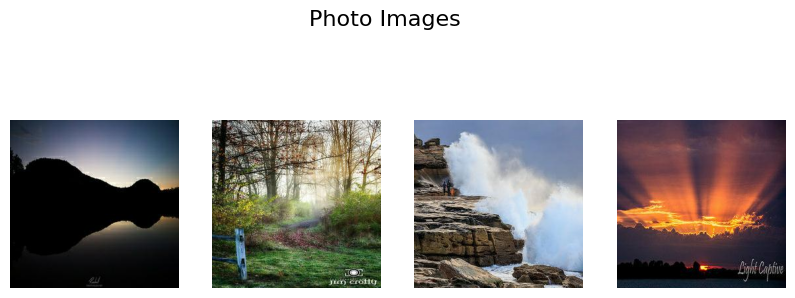

In [17]:
def show_random(folder, title):
    files = random.sample(glob(folder + "*.jpg"), 4)
    plt.figure(figsize=(10,4))
    plt.suptitle(title, fontsize=16)
    for i, f in enumerate(files):
        plt.subplot(1,4,i+1)
        plt.imshow(Image.open(f))
        plt.axis("off")
    plt.show()

show_random(MONET_JPG, "Monet Images")
show_random(PHOTO_JPG, "Photo Images")

<h2>Data Processing</h2>

Since the number of Monet images is 300 and the number of photos is 7068, they are unbalanced.

So I am cycles the Monet images to make sure there is a Monet image training with a photo.


In [18]:
# DATASET CLASS

class ImageDataset(Dataset):
    def __init__(self, monet_paths, photo_paths, transforms):
        self.monet_paths = monet_paths
        self.photo_paths = photo_paths
        self.transforms = transforms

    def __len__(self):
        return max(len(self.monet_paths), len(self.photo_paths))

    def __getitem__(self, idx):
        monet_img = Image.open(self.monet_paths[idx % len(self.monet_paths)]).convert("RGB")
        photo_img = Image.open(self.photo_paths[idx % len(self.photo_paths)]).convert("RGB")
        return {
            "monet": self.transforms(monet_img),
            "photo": self.transforms(photo_img)
        }

In [19]:
transforms = T.Compose([
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.ToTensor(),
    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) 
])

dataset = ImageDataset(monet_paths, photo_paths, transforms)
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
len(loader)

1760

<h1>Model Architecture</h1>

The PatchGAN discriminator converts the 256*256 image into a 31*31 patch map. It outputs a map of scores, which has one score per receptive patch in the input image.

For residual block, I applied two 3×3 convolutions, with instance norm + ReLU between them, then added the input back. So output = x + F(x). This residual connection helps training deeper networks by allowing gradients to flow through the identity path.

ResNet Generator
Inital create a 7×7 large kernel helps capture larger context,then downsampling with 2 convolution layers,apply residual block to keep the connection, then upsampling 2 convolution layers back to resize the image to 256*256. Finally, let's produce 3×256×256 output in range -1 to 1.

In [20]:
# --- PatchGAN Discriminator ---
class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super().__init__()
        def block(input_dim, output_dim, norm=True):
            layers = [nn.Conv2d(input_dim, output_dim, 4, 2, 1)]
            if norm:
                layers.append(nn.InstanceNorm2d(output_dim))
            layers.append(nn.LeakyReLU(0.2, True))
            return layers

        self.model = nn.Sequential(
            *block(in_channels, 64, norm=False),
            *block(64, 128),
            *block(128, 256),
            nn.Conv2d(256, 1, 4, 1, 1)
        )

    def forward(self, x):
        return self.model(x)


# --- Residual Block ---
class ResidualBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(dim, dim, 3, 1, 1),
            nn.InstanceNorm2d(dim),
            nn.ReLU(True),
            nn.Conv2d(dim, dim, 3, 1, 1),
            nn.InstanceNorm2d(dim)
        )

    def forward(self, x):
        return x + self.block(x)


# --- ResNet Generator ---
class Generator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, n_residuals=6):
        super().__init__()

        model = [
            nn.Conv2d(in_channels, 64, 7, 1, 3),
            nn.InstanceNorm2d(64),
            nn.ReLU(True)
        ]

        # Downsampling
        dims = [64, 128, 256]
        for i in range(2):
            model += [
                nn.Conv2d(dims[i], dims[i+1], 3, 2, 1),
                nn.InstanceNorm2d(dims[i+1]),
                nn.ReLU(True)
            ]

        for _ in range(n_residuals):
            model.append(ResidualBlock(256))

        # Upsampling
        for i in range(2):
            model += [
                nn.ConvTranspose2d(dims[2-i], dims[1-i], 3, 2, 1, output_padding=1),
                nn.InstanceNorm2d(dims[1-i]),
                nn.ReLU(True)
            ]

        model += [
            nn.Conv2d(64, out_channels, 7, 1, 3),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)


GANs needs 2 generators: one is to take a real photo and generates a Monet-style image. Another one is to take a Monet painting and generates a realistic photo.

Then we also got 2 discriminators: one is to decides if an image is a real Monet image or a fake Monet image. Another one is to decide if an image is a real photo or a fake photo.

In [27]:
G_PHOTO2MONET = Generator().to(device)
G_MONET2PHOTO = Generator().to(device)

D_MONET = Discriminator().to(device)
D_PHOTO = Discriminator().to(device)

g_opt = optim.Adam(
    list(G_PHOTO2MONET.parameters()) + list(G_MONET2PHOTO.parameters()),
    lr=LR, betas=(0.5, 0.999)
)
d_opt = optim.Adam(
    list(D_MONET.parameters()) + list(D_PHOTO.parameters()),
    lr=LR, betas=(0.5, 0.999)
)

adv_criterion = nn.MSELoss()
cycle_criterion = nn.L1Loss()
identity_criterion = nn.L1Loss()


Training:
Tested trains CycleGAN for 20-40 epochs. The 20-epoch result captures the Monet style but not very good. For submission I raised to 40 epochs.
It costs a lot of time for training, so I limited the number of steps per epoch to speed up training. And it generates sample Monet-style images every epoch.


Epoch 1/40


 11%|█▏        | 200/1760 [03:05<24:03,  1.08it/s]


Epoch 1 Sample 0: min=-0.962, max=0.999
Epoch 1 Sample 1: min=-0.964, max=0.961
Epoch 1 Sample 2: min=-0.974, max=0.911
Epoch 1 Sample 3: min=-0.974, max=0.905
Epoch 1 Sample 4: min=-0.999, max=0.965


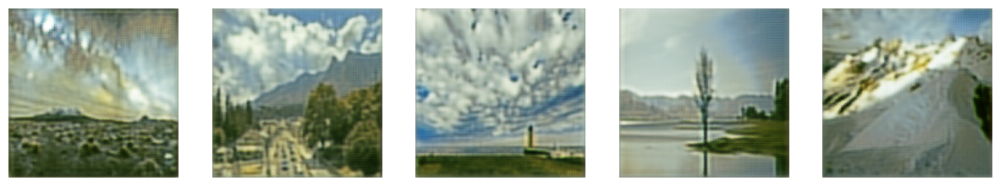

Epoch 1 | Avg Generator Loss: 9.0156 | Avg Discriminator Loss: 0.4980

Epoch 2/40


 11%|█▏        | 200/1760 [03:05<24:03,  1.08it/s]


Epoch 2 Sample 0: min=-0.992, max=0.995
Epoch 2 Sample 1: min=-0.991, max=0.865
Epoch 2 Sample 2: min=-0.977, max=0.812
Epoch 2 Sample 3: min=-0.977, max=0.819
Epoch 2 Sample 4: min=-0.999, max=0.918


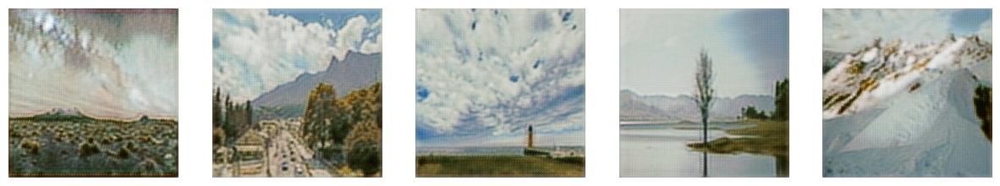

Epoch 2 | Avg Generator Loss: 7.7492 | Avg Discriminator Loss: 0.4254

Epoch 3/40


 11%|█▏        | 200/1760 [03:05<24:03,  1.08it/s]


Epoch 3 Sample 0: min=-0.976, max=1.000
Epoch 3 Sample 1: min=-0.943, max=0.915
Epoch 3 Sample 2: min=-0.948, max=0.883
Epoch 3 Sample 3: min=-0.941, max=0.941
Epoch 3 Sample 4: min=-0.987, max=0.969


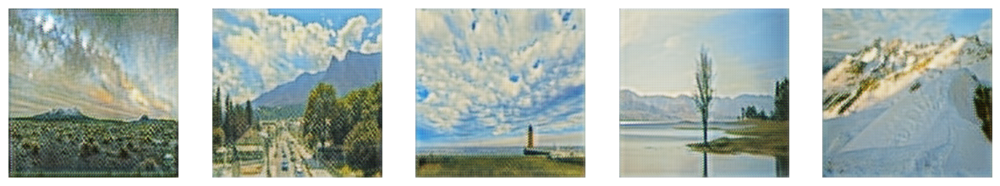

Epoch 3 | Avg Generator Loss: 7.3717 | Avg Discriminator Loss: 0.3941

Epoch 4/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 4 Sample 0: min=-0.969, max=0.987
Epoch 4 Sample 1: min=-0.955, max=0.855
Epoch 4 Sample 2: min=-0.982, max=0.815
Epoch 4 Sample 3: min=-0.940, max=0.846
Epoch 4 Sample 4: min=-0.990, max=0.892


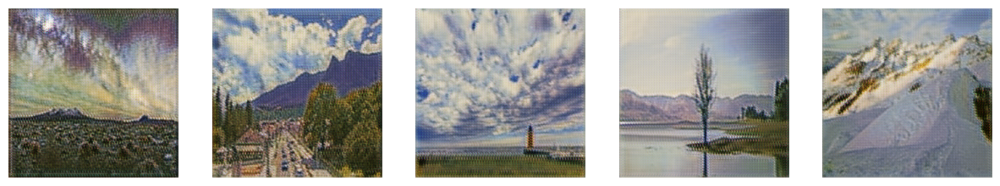

Epoch 4 | Avg Generator Loss: 7.2016 | Avg Discriminator Loss: 0.3898

Epoch 5/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 5 Sample 0: min=-0.961, max=0.993
Epoch 5 Sample 1: min=-0.944, max=0.872
Epoch 5 Sample 2: min=-0.980, max=0.857
Epoch 5 Sample 3: min=-0.942, max=0.873
Epoch 5 Sample 4: min=-0.976, max=0.898


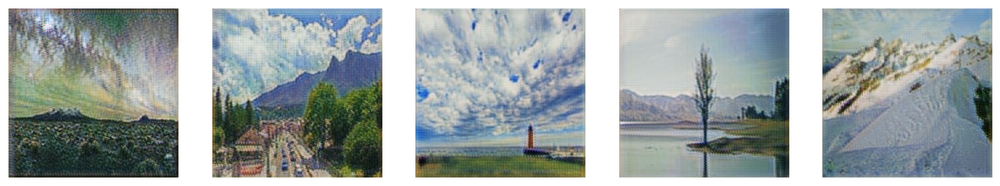

Epoch 5 | Avg Generator Loss: 6.7707 | Avg Discriminator Loss: 0.3875

Epoch 6/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 6 Sample 0: min=-0.991, max=0.989
Epoch 6 Sample 1: min=-0.983, max=0.891
Epoch 6 Sample 2: min=-0.967, max=0.878
Epoch 6 Sample 3: min=-0.948, max=0.927
Epoch 6 Sample 4: min=-0.992, max=0.887


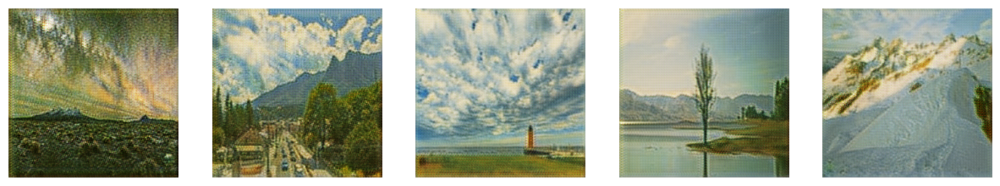

Epoch 6 | Avg Generator Loss: 6.4569 | Avg Discriminator Loss: 0.3959

Epoch 7/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 7 Sample 0: min=-0.976, max=0.990
Epoch 7 Sample 1: min=-0.958, max=0.937
Epoch 7 Sample 2: min=-0.942, max=0.878
Epoch 7 Sample 3: min=-0.945, max=0.950
Epoch 7 Sample 4: min=-0.970, max=0.910


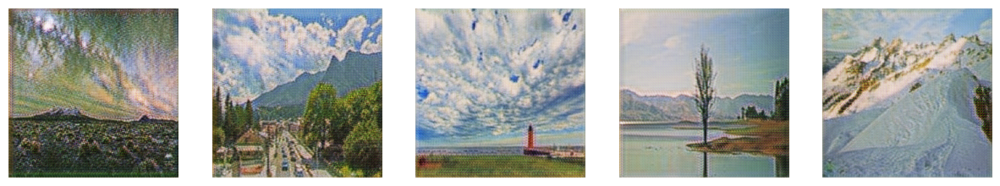

Epoch 7 | Avg Generator Loss: 6.2096 | Avg Discriminator Loss: 0.3878

Epoch 8/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 8 Sample 0: min=-0.977, max=0.957
Epoch 8 Sample 1: min=-0.969, max=0.889
Epoch 8 Sample 2: min=-0.976, max=0.868
Epoch 8 Sample 3: min=-0.950, max=0.911
Epoch 8 Sample 4: min=-0.987, max=0.917


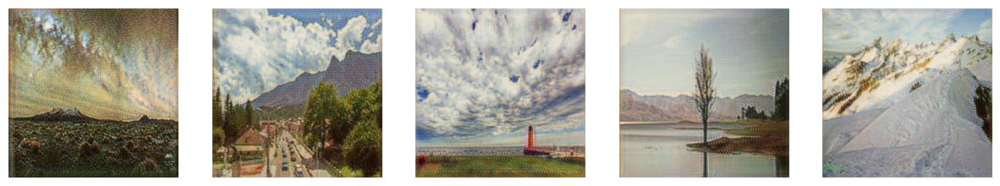

Epoch 8 | Avg Generator Loss: 6.0396 | Avg Discriminator Loss: 0.3925

Epoch 9/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 9 Sample 0: min=-0.969, max=0.993
Epoch 9 Sample 1: min=-0.956, max=0.922
Epoch 9 Sample 2: min=-0.975, max=0.896
Epoch 9 Sample 3: min=-0.955, max=0.932
Epoch 9 Sample 4: min=-0.978, max=0.918


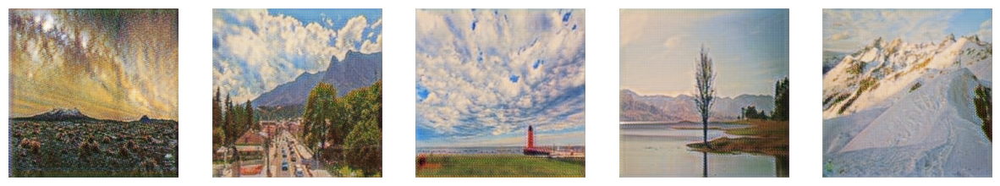

Epoch 9 | Avg Generator Loss: 5.8771 | Avg Discriminator Loss: 0.3794

Epoch 10/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 10 Sample 0: min=-0.962, max=0.937
Epoch 10 Sample 1: min=-0.922, max=0.929
Epoch 10 Sample 2: min=-0.981, max=0.904
Epoch 10 Sample 3: min=-0.958, max=0.919
Epoch 10 Sample 4: min=-0.983, max=0.933


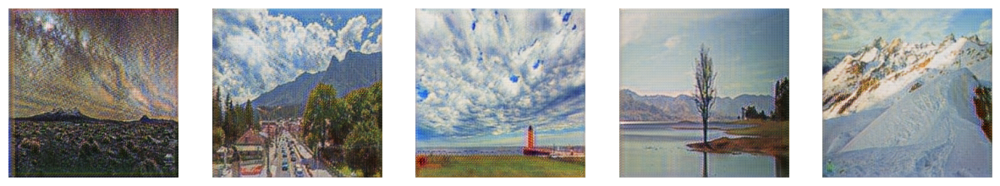

Epoch 10 | Avg Generator Loss: 5.8270 | Avg Discriminator Loss: 0.3776

Epoch 11/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 11 Sample 0: min=-0.971, max=0.923
Epoch 11 Sample 1: min=-0.933, max=0.826
Epoch 11 Sample 2: min=-0.969, max=0.824
Epoch 11 Sample 3: min=-0.963, max=0.940
Epoch 11 Sample 4: min=-0.971, max=0.924


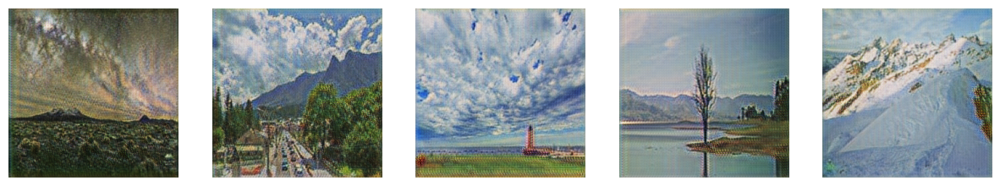

Epoch 11 | Avg Generator Loss: 5.8532 | Avg Discriminator Loss: 0.3701

Epoch 12/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 12 Sample 0: min=-0.961, max=0.973
Epoch 12 Sample 1: min=-0.944, max=0.896
Epoch 12 Sample 2: min=-0.960, max=0.866
Epoch 12 Sample 3: min=-0.957, max=0.835
Epoch 12 Sample 4: min=-0.974, max=0.877


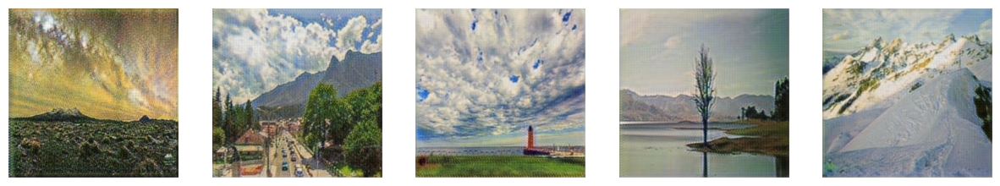

Epoch 12 | Avg Generator Loss: 5.4353 | Avg Discriminator Loss: 0.4404

Epoch 13/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 13 Sample 0: min=-0.946, max=0.953
Epoch 13 Sample 1: min=-0.916, max=0.890
Epoch 13 Sample 2: min=-0.947, max=0.903
Epoch 13 Sample 3: min=-0.945, max=0.923
Epoch 13 Sample 4: min=-0.929, max=0.926


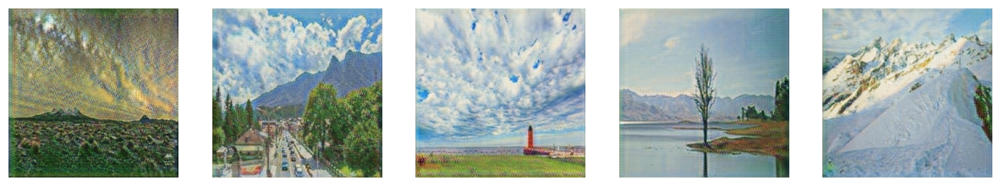

Epoch 13 | Avg Generator Loss: 5.3598 | Avg Discriminator Loss: 0.3650

Epoch 14/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 14 Sample 0: min=-0.962, max=0.984
Epoch 14 Sample 1: min=-0.939, max=0.866
Epoch 14 Sample 2: min=-0.975, max=0.908
Epoch 14 Sample 3: min=-0.943, max=0.918
Epoch 14 Sample 4: min=-0.969, max=0.922


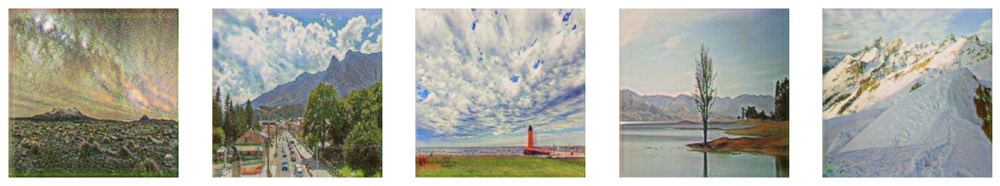

Epoch 14 | Avg Generator Loss: 5.4671 | Avg Discriminator Loss: 0.3462

Epoch 15/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 15 Sample 0: min=-0.956, max=0.887
Epoch 15 Sample 1: min=-0.884, max=0.866
Epoch 15 Sample 2: min=-0.957, max=0.911
Epoch 15 Sample 3: min=-0.935, max=0.852
Epoch 15 Sample 4: min=-0.915, max=0.931


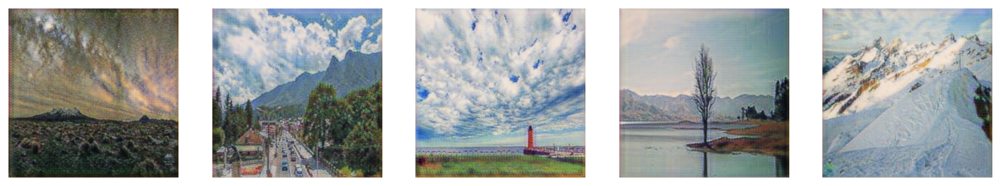

Epoch 15 | Avg Generator Loss: 5.3925 | Avg Discriminator Loss: 0.3390

Epoch 16/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 16 Sample 0: min=-0.940, max=0.862
Epoch 16 Sample 1: min=-0.889, max=0.909
Epoch 16 Sample 2: min=-0.974, max=0.900
Epoch 16 Sample 3: min=-0.953, max=0.917
Epoch 16 Sample 4: min=-0.924, max=0.891


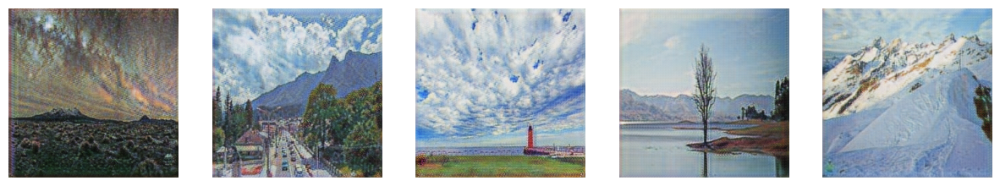

Epoch 16 | Avg Generator Loss: 5.3657 | Avg Discriminator Loss: 0.3226

Epoch 17/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 17 Sample 0: min=-0.937, max=0.949
Epoch 17 Sample 1: min=-0.916, max=0.890
Epoch 17 Sample 2: min=-0.963, max=0.879
Epoch 17 Sample 3: min=-0.955, max=0.867
Epoch 17 Sample 4: min=-0.938, max=0.878


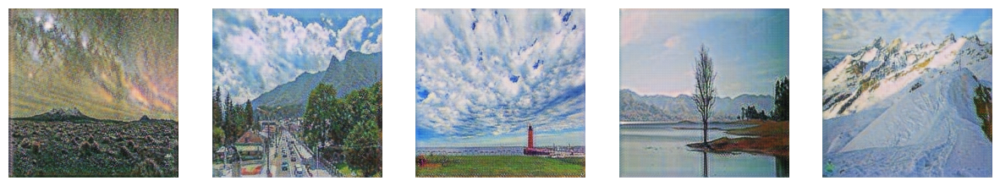

Epoch 17 | Avg Generator Loss: 5.2787 | Avg Discriminator Loss: 0.3000

Epoch 18/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 18 Sample 0: min=-0.943, max=0.833
Epoch 18 Sample 1: min=-0.944, max=0.961
Epoch 18 Sample 2: min=-0.973, max=0.954
Epoch 18 Sample 3: min=-0.962, max=0.911
Epoch 18 Sample 4: min=-0.983, max=0.946


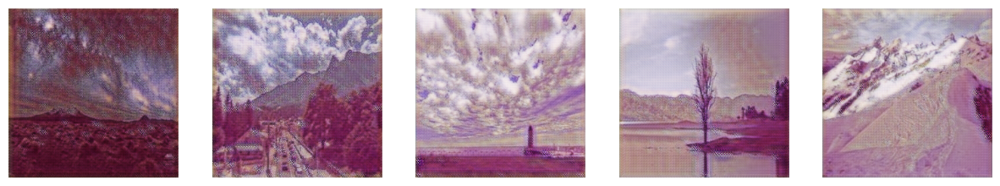

Epoch 18 | Avg Generator Loss: 5.3517 | Avg Discriminator Loss: 0.3194

Epoch 19/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 19 Sample 0: min=-0.936, max=0.919
Epoch 19 Sample 1: min=-0.954, max=0.912
Epoch 19 Sample 2: min=-0.941, max=0.870
Epoch 19 Sample 3: min=-0.938, max=0.861
Epoch 19 Sample 4: min=-0.960, max=0.892


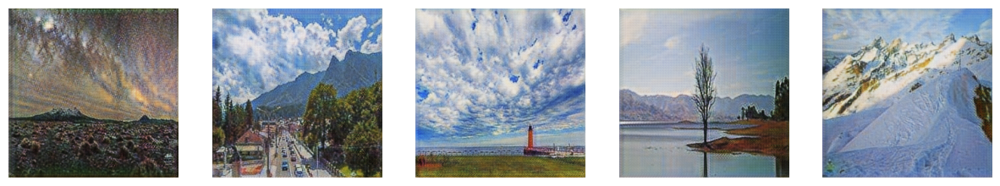

Epoch 19 | Avg Generator Loss: 4.9796 | Avg Discriminator Loss: 0.3806

Epoch 20/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 20 Sample 0: min=-0.972, max=0.905
Epoch 20 Sample 1: min=-0.963, max=0.865
Epoch 20 Sample 2: min=-0.981, max=0.869
Epoch 20 Sample 3: min=-0.974, max=0.853
Epoch 20 Sample 4: min=-0.975, max=0.846


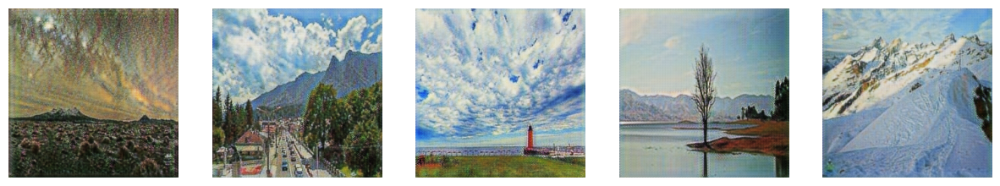

Epoch 20 | Avg Generator Loss: 4.8415 | Avg Discriminator Loss: 0.2629

Epoch 21/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 21 Sample 0: min=-0.956, max=0.923
Epoch 21 Sample 1: min=-0.956, max=0.940
Epoch 21 Sample 2: min=-0.959, max=0.894
Epoch 21 Sample 3: min=-0.949, max=0.857
Epoch 21 Sample 4: min=-0.956, max=0.870


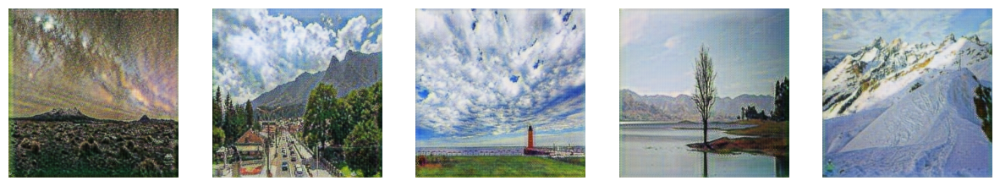

Epoch 21 | Avg Generator Loss: 4.9418 | Avg Discriminator Loss: 0.2453

Epoch 22/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 22 Sample 0: min=-0.931, max=0.953
Epoch 22 Sample 1: min=-0.880, max=0.923
Epoch 22 Sample 2: min=-0.854, max=0.897
Epoch 22 Sample 3: min=-0.944, max=0.944
Epoch 22 Sample 4: min=-0.947, max=0.873


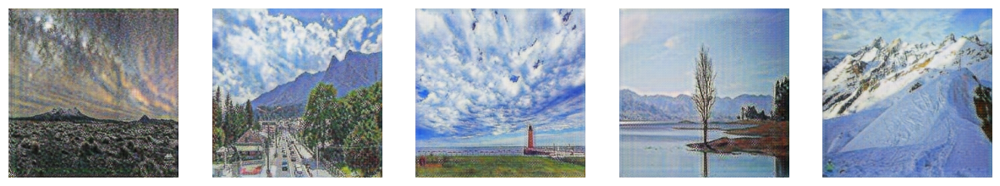

Epoch 22 | Avg Generator Loss: 5.0196 | Avg Discriminator Loss: 0.2625

Epoch 23/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 23 Sample 0: min=-0.962, max=0.916
Epoch 23 Sample 1: min=-0.942, max=0.904
Epoch 23 Sample 2: min=-0.929, max=0.847
Epoch 23 Sample 3: min=-0.953, max=0.899
Epoch 23 Sample 4: min=-0.940, max=0.858


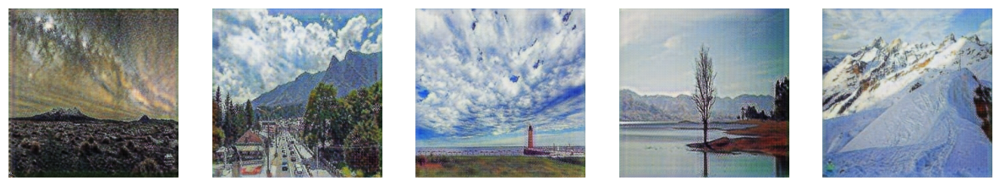

Epoch 23 | Avg Generator Loss: 4.8738 | Avg Discriminator Loss: 0.2824

Epoch 24/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 24 Sample 0: min=-0.964, max=0.937
Epoch 24 Sample 1: min=-0.971, max=0.908
Epoch 24 Sample 2: min=-0.969, max=0.900
Epoch 24 Sample 3: min=-0.963, max=0.942
Epoch 24 Sample 4: min=-0.961, max=0.855


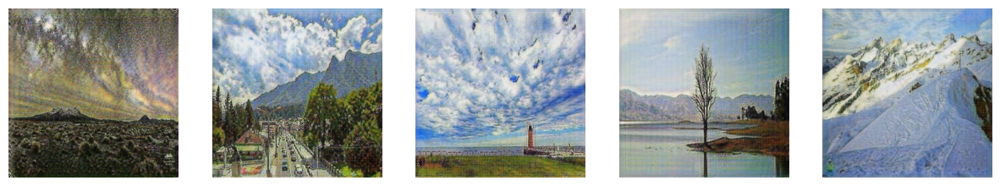

Epoch 24 | Avg Generator Loss: 4.8406 | Avg Discriminator Loss: 0.3016

Epoch 25/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 25 Sample 0: min=-0.924, max=0.939
Epoch 25 Sample 1: min=-0.922, max=0.881
Epoch 25 Sample 2: min=-0.911, max=0.864
Epoch 25 Sample 3: min=-0.942, max=0.846
Epoch 25 Sample 4: min=-0.922, max=0.833


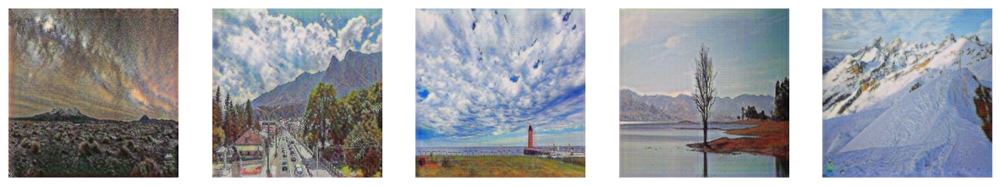

Epoch 25 | Avg Generator Loss: 4.7189 | Avg Discriminator Loss: 0.2966

Epoch 26/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 26 Sample 0: min=-0.823, max=0.953
Epoch 26 Sample 1: min=-0.830, max=0.886
Epoch 26 Sample 2: min=-0.883, max=0.977
Epoch 26 Sample 3: min=-0.908, max=0.951
Epoch 26 Sample 4: min=-0.948, max=0.970


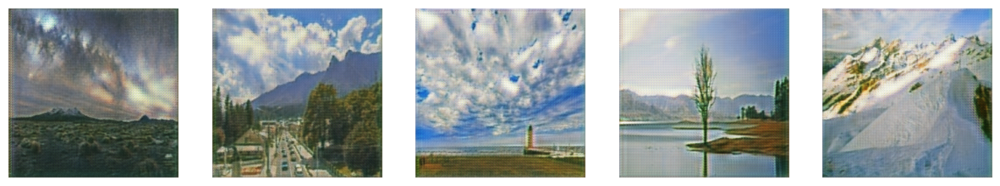

Epoch 26 | Avg Generator Loss: 5.8278 | Avg Discriminator Loss: 0.6164

Epoch 27/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 27 Sample 0: min=-0.866, max=0.894
Epoch 27 Sample 1: min=-0.817, max=0.862
Epoch 27 Sample 2: min=-0.755, max=0.914
Epoch 27 Sample 3: min=-0.882, max=0.904
Epoch 27 Sample 4: min=-0.888, max=0.905


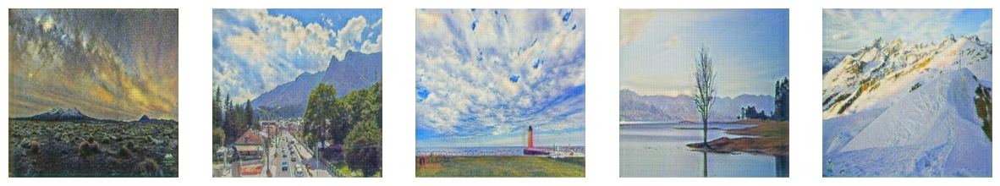

Epoch 27 | Avg Generator Loss: 5.3128 | Avg Discriminator Loss: 0.3076

Epoch 28/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 28 Sample 0: min=-0.951, max=0.941
Epoch 28 Sample 1: min=-0.836, max=0.922
Epoch 28 Sample 2: min=-0.845, max=0.931
Epoch 28 Sample 3: min=-0.877, max=0.885
Epoch 28 Sample 4: min=-0.922, max=0.923


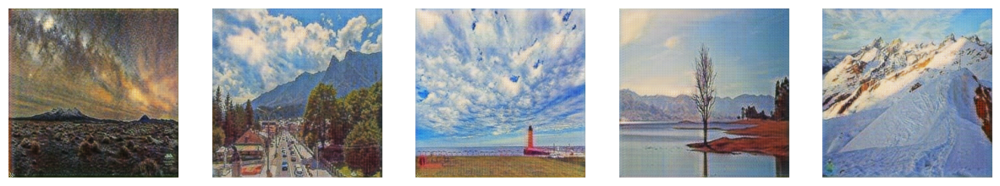

Epoch 28 | Avg Generator Loss: 4.7938 | Avg Discriminator Loss: 0.3026

Epoch 29/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 29 Sample 0: min=-0.905, max=0.953
Epoch 29 Sample 1: min=-0.880, max=0.910
Epoch 29 Sample 2: min=-0.876, max=0.950
Epoch 29 Sample 3: min=-0.900, max=0.922
Epoch 29 Sample 4: min=-0.906, max=0.924


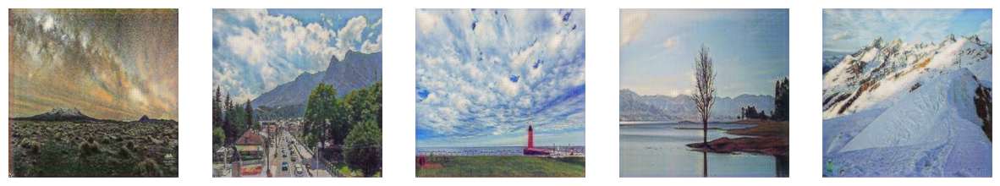

Epoch 29 | Avg Generator Loss: 4.7127 | Avg Discriminator Loss: 0.2880

Epoch 30/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 30 Sample 0: min=-0.956, max=0.956
Epoch 30 Sample 1: min=-0.938, max=0.938
Epoch 30 Sample 2: min=-0.782, max=0.913
Epoch 30 Sample 3: min=-0.945, max=0.892
Epoch 30 Sample 4: min=-0.936, max=0.929


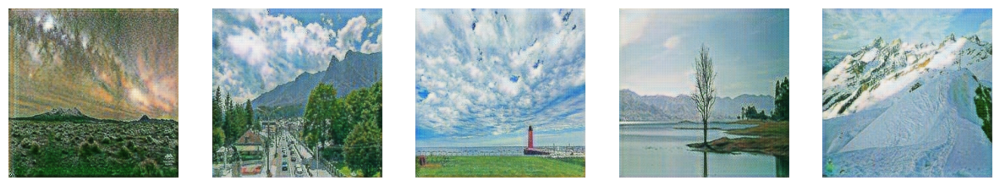

Epoch 30 | Avg Generator Loss: 4.6753 | Avg Discriminator Loss: 0.2774

Epoch 31/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 31 Sample 0: min=-0.953, max=0.940
Epoch 31 Sample 1: min=-0.914, max=0.884
Epoch 31 Sample 2: min=-0.804, max=0.869
Epoch 31 Sample 3: min=-0.907, max=0.828
Epoch 31 Sample 4: min=-0.940, max=0.874


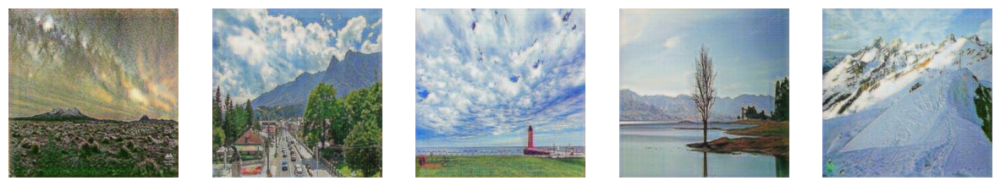

Epoch 31 | Avg Generator Loss: 4.7380 | Avg Discriminator Loss: 0.2698

Epoch 32/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 32 Sample 0: min=-0.975, max=0.976
Epoch 32 Sample 1: min=-0.927, max=0.955
Epoch 32 Sample 2: min=-0.747, max=0.836
Epoch 32 Sample 3: min=-0.856, max=0.812
Epoch 32 Sample 4: min=-0.902, max=0.864


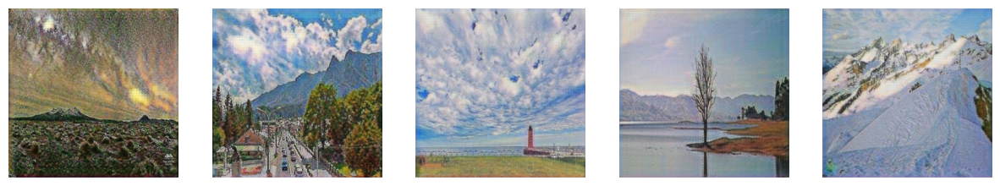

Epoch 32 | Avg Generator Loss: 5.3731 | Avg Discriminator Loss: 0.4535

Epoch 33/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 33 Sample 0: min=-0.975, max=0.968
Epoch 33 Sample 1: min=-0.935, max=0.889
Epoch 33 Sample 2: min=-0.814, max=0.858
Epoch 33 Sample 3: min=-0.875, max=0.767
Epoch 33 Sample 4: min=-0.915, max=0.863


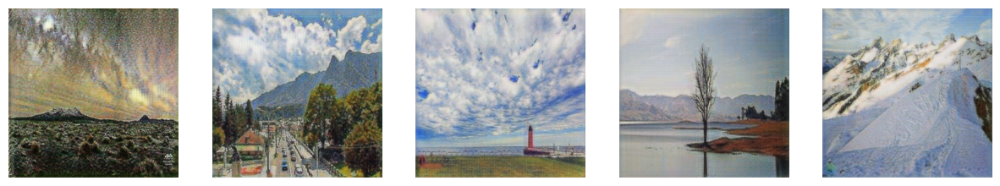

Epoch 33 | Avg Generator Loss: 4.6188 | Avg Discriminator Loss: 0.3233

Epoch 34/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 34 Sample 0: min=-0.927, max=0.985
Epoch 34 Sample 1: min=-0.948, max=0.952
Epoch 34 Sample 2: min=-0.747, max=0.910
Epoch 34 Sample 3: min=-0.892, max=0.839
Epoch 34 Sample 4: min=-0.862, max=0.899


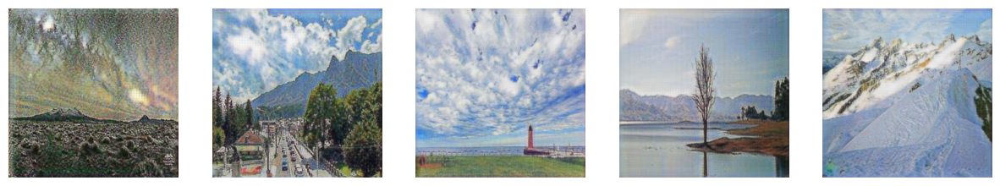

Epoch 34 | Avg Generator Loss: 4.5263 | Avg Discriminator Loss: 0.3033

Epoch 35/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 35 Sample 0: min=-0.976, max=0.954
Epoch 35 Sample 1: min=-0.969, max=0.925
Epoch 35 Sample 2: min=-0.816, max=0.831
Epoch 35 Sample 3: min=-0.898, max=0.805
Epoch 35 Sample 4: min=-0.925, max=0.817


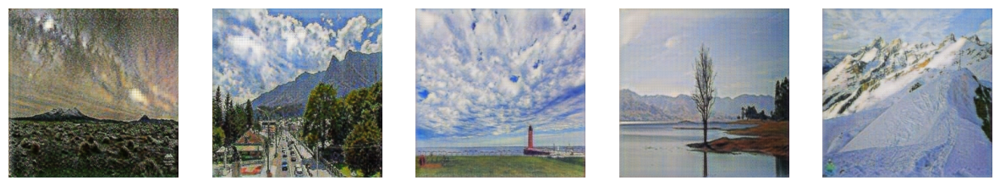

Epoch 35 | Avg Generator Loss: 4.4178 | Avg Discriminator Loss: 0.2915

Epoch 36/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 36 Sample 0: min=-0.978, max=0.971
Epoch 36 Sample 1: min=-0.970, max=0.922
Epoch 36 Sample 2: min=-0.803, max=0.900
Epoch 36 Sample 3: min=-0.889, max=0.786
Epoch 36 Sample 4: min=-0.880, max=0.887


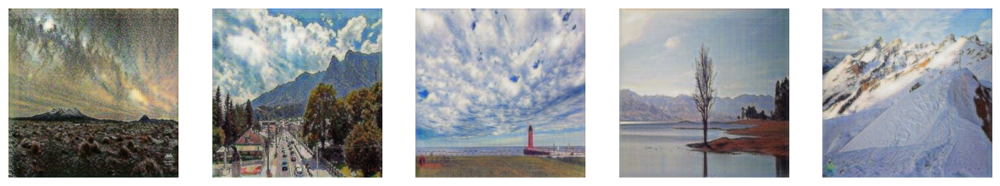

Epoch 36 | Avg Generator Loss: 4.5476 | Avg Discriminator Loss: 0.2826

Epoch 37/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 37 Sample 0: min=-0.933, max=0.900
Epoch 37 Sample 1: min=-0.922, max=0.885
Epoch 37 Sample 2: min=-0.839, max=0.886
Epoch 37 Sample 3: min=-0.935, max=0.880
Epoch 37 Sample 4: min=-0.939, max=0.914


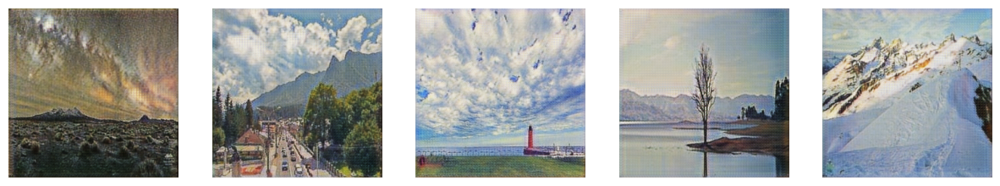

Epoch 37 | Avg Generator Loss: 4.9946 | Avg Discriminator Loss: 0.6092

Epoch 38/40


 11%|█▏        | 200/1760 [03:04<24:01,  1.08it/s]


Epoch 38 Sample 0: min=-0.956, max=0.975
Epoch 38 Sample 1: min=-0.945, max=0.955
Epoch 38 Sample 2: min=-0.880, max=0.885
Epoch 38 Sample 3: min=-0.932, max=0.902
Epoch 38 Sample 4: min=-0.922, max=0.879


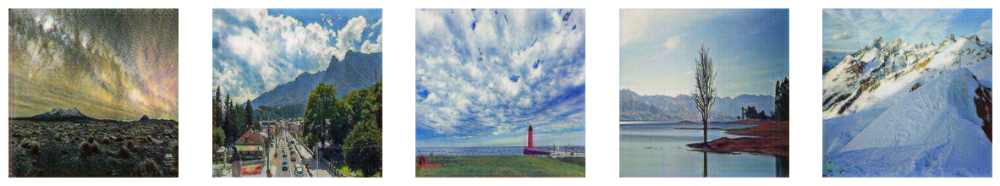

Epoch 38 | Avg Generator Loss: 4.2969 | Avg Discriminator Loss: 0.3248

Epoch 39/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 39 Sample 0: min=-0.981, max=0.969
Epoch 39 Sample 1: min=-0.962, max=0.907
Epoch 39 Sample 2: min=-0.821, max=0.849
Epoch 39 Sample 3: min=-0.901, max=0.785
Epoch 39 Sample 4: min=-0.877, max=0.838


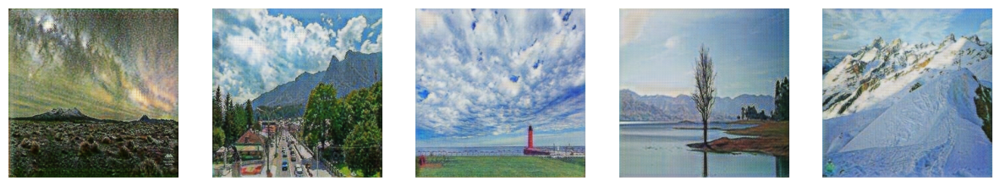

Epoch 39 | Avg Generator Loss: 4.1554 | Avg Discriminator Loss: 0.3004

Epoch 40/40


 11%|█▏        | 200/1760 [03:04<24:02,  1.08it/s]


Epoch 40 Sample 0: min=-0.954, max=0.975
Epoch 40 Sample 1: min=-0.969, max=0.936
Epoch 40 Sample 2: min=-0.864, max=0.875
Epoch 40 Sample 3: min=-0.952, max=0.897
Epoch 40 Sample 4: min=-0.934, max=0.898


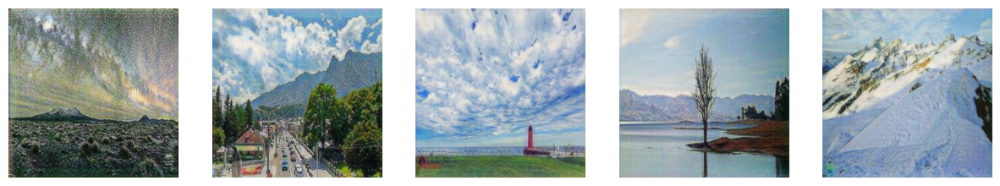

Epoch 40 | Avg Generator Loss: 4.2283 | Avg Discriminator Loss: 0.2961


In [22]:
# Pick a small set of photos for monitoring
SAMPLE_SIZE = 5
sample_photo_paths = random.sample(photo_paths, SAMPLE_SIZE)

for epoch in range(NUM_EPOCHS):
    print(f"\nEpoch {epoch+1}/{NUM_EPOCHS}")
    g_loss_epoch = 0.0
    d_loss_epoch = 0.0

    for step, batch in enumerate(tqdm(loader)):
        if step >= MAX_STEPS:
            break  # limit steps per epoch

        real_monet = batch["monet"].to(device)
        real_photo = batch["photo"].to(device)

        
        # Train Discriminators
        fake_monet = G_PHOTO2MONET(real_photo).detach()
        fake_photo = G_MONET2PHOTO(real_monet).detach()

        d_opt.zero_grad()

        d_real_monet = D_MONET(real_monet)
        d_fake_monet = D_MONET(fake_monet)
        d_real_photo = D_PHOTO(real_photo)
        d_fake_photo = D_PHOTO(fake_photo)

        real_labels = torch.ones_like(d_real_monet)
        fake_labels = torch.zeros_like(d_fake_monet)

        d_loss_monet = adv_criterion(d_real_monet, real_labels) + adv_criterion(d_fake_monet, fake_labels)
        d_loss_photo = adv_criterion(d_real_photo, real_labels) + adv_criterion(d_fake_photo, fake_labels)

        d_loss = 0.5 * (d_loss_monet + d_loss_photo)
        d_loss.backward()
        d_opt.step()


        # Train Generators
        g_opt.zero_grad()

        fake_monet = G_PHOTO2MONET(real_photo)
        fake_photo = G_MONET2PHOTO(real_monet)

        pred_fake_monet = D_MONET(fake_monet)
        pred_fake_photo = D_PHOTO(fake_photo)

        adv_loss = adv_criterion(pred_fake_monet, real_labels) + adv_criterion(pred_fake_photo, real_labels)

        cycle_photo = G_MONET2PHOTO(fake_monet)
        cycle_monet = G_PHOTO2MONET(fake_photo)
        cycle_loss = cycle_criterion(cycle_photo, real_photo) + cycle_criterion(cycle_monet, real_monet)

        id_photo = G_MONET2PHOTO(real_photo)
        id_monet = G_PHOTO2MONET(real_monet)
        id_loss = identity_criterion(id_photo, real_photo) + identity_criterion(id_monet, real_monet)

        g_loss = adv_loss + LAMBDA_CYCLE * cycle_loss + LAMBDA_IDENTITY * id_loss
        g_loss.backward()
        g_opt.step()

        g_loss_epoch += g_loss.item()
        d_loss_epoch += d_loss.item()


    # Generate Test Samples for Monitoring
    G_PHOTO2MONET.eval()
    with torch.no_grad():
        fig, axes = plt.subplots(1, SAMPLE_SIZE, figsize=(15, 5))
        for idx, img_path in enumerate(sample_photo_paths):
            img = Image.open(img_path).convert("RGB")
            img = transforms(img).unsqueeze(0).to(device)

            fake_monet = G_PHOTO2MONET(img)
            print(f"Epoch {epoch+1} Sample {idx}: min={fake_monet.min().item():.3f}, max={fake_monet.max().item():.3f}")

            # Denormalize
            fake_monet_img = (fake_monet[0] * 0.5 + 0.5).clamp(0, 1)
            fake_monet_img = T.ToPILImage()(fake_monet_img.cpu())
            axes[idx].imshow(fake_monet_img)
            axes[idx].axis("off")
        plt.show()
    G_PHOTO2MONET.train()

    print(f"Epoch {epoch+1} | Avg Generator Loss: {g_loss_epoch/MAX_STEPS:.4f} | Avg Discriminator Loss: {d_loss_epoch/MAX_STEPS:.4f}")

<h2>Test with samples</h2>
Test with a Small number of images for a quick result

In [23]:
# Test Generation: Small Sample

NUM_TEST_IMAGES = 10  # small number for quick test
os.makedirs("test_images", exist_ok=True)

with torch.no_grad():
    for idx in range(NUM_TEST_IMAGES):
        # Pick a random photo from the dataset
        img_path = random.choice(photo_paths)
        img = Image.open(img_path).convert("RGB")
        img = transforms(img).unsqueeze(0).to(device)

        # Generate Monet-style image
        fake_monet = G_PHOTO2MONET(img)
        fake_monet = (fake_monet[0] * 0.5 + 0.5).clamp(0, 1)
        fake_monet = T.ToPILImage()(fake_monet.cpu())

        # Save test image
        fake_monet.save(f"test_images/{idx}.jpg")

print("Test generation complete. Check 'test_images/' folder for outputs.")


Test generation complete. Check 'test_images/' folder for outputs.


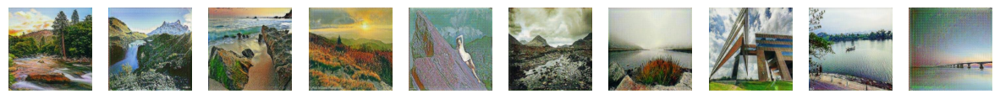

In [24]:
# Get test images
test_imgs = sorted(glob("test_images/*.jpg"))

# Set up plot
fig, axes = plt.subplots(1, len(test_imgs), figsize=(15, 5))

for ax, img_path in zip(axes, test_imgs):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis("off")

plt.show()

<h1>Result and Analysis</h1>

In [31]:
# GENERATE SUBMISSION IMAGES
import zipfile

from torchvision.utils import save_image

SUBMISSION_DIR = "images"  # folder for all images
os.makedirs(SUBMISSION_DIR, exist_ok=True)


# Generate Images
photo_files = glob(PHOTO_JPG + "*.jpg")
N_IMAGES = 7000  

print(f"Generating {N_IMAGES} Monet-style images...")

G_PHOTO2MONET.eval() # set generator to eval mode
with torch.no_grad():
    for idx, img_path in enumerate(tqdm(photo_files[:N_IMAGES])):
        img = Image.open(img_path).convert("RGB")
        img = transforms(img).unsqueeze(0).to(device)

        monet = G_PHOTO2MONET(img)[0].cpu()
        monet = (monet * 0.5 + 0.5).clamp(0, 1)  # denormalize to [0,1]

        # Save as 256x256 JPG
        save_image(monet, f"{SUBMISSION_DIR}/{idx}.jpg")

print("Completed. Total images:", len(os.listdir(SUBMISSION_DIR)))


# Create ZIP for submission
zip_filename = "images.zip"
with zipfile.ZipFile(zip_filename, 'w') as zipf:
    for file in sorted(os.listdir(SUBMISSION_DIR)):
        zipf.write(os.path.join(SUBMISSION_DIR, file), arcname=file)

print(f"Submission zip created: {zip_filename}")


Generating 7000 Monet-style images...


100%|██████████| 7000/7000 [01:46<00:00, 65.72it/s]


Completed. Total images: 7000
Submission zip created: images.zip


<h1>Conclusion</h1>
This project we did a CycleGAN training pipeline.

I met the issue that training takes forever, solving it with limited training data by setting up a max step for each epoch. It stabilized training time while still allowing the generators and discriminators to converge. 

The combination of adversarial, cycle-consistency, and identity losses enabled the model to preserve scene structure while translating style effectively. Periodic sample generation also allowed us to visually confirm that outputs gradually moved closer to Monet-like textures and colors across epochs.

<h1>Reference</h1>
What is a GAN? https://aws.amazon.com/what-is/gan/

Monet cyclegan tutorial: https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial


<h1>GitHub</h1>
https://github.com/meng-shi/GAN-Monet